<a href="https://colab.research.google.com/github/bozanastanimirovic/PPPO-Detekcija-objekata/blob/main/PPPO_Detekcija_automobila.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Uvod

Tema ovog projekta je detekcija objekata, tačnije automobila. Dobila sam početni skup podataka, folder sa fotografijama za trening i testiranje kao i CSV fajl koji sadrži koordinate za bounding box za svaki automobil na training setu podataka. Cilj projekta jeste da korišćenjem potrebnih tehnologija i modela treniramo model i da omogućimo prepoznavanje automobila na fotografijama i iscrtavamo bounding box i da testiramo na kraju njegove performanse. Za razvoj rešenja ovog projekta izabrala sam YOLOv5 algoritam (You Only Look Once) koji predstavlja jedan od algoritama koji služe za detekcije objekata. Radi po principu jednog prolaska kroz fotografiju, odnosno obrađuje je u jednom prolazu, što ga čini izrazito brzim. Takođe je vrlo precizan i lak za korišćenje, pogodniji je za korišćenje od prethodnih verzija (YOLOv3).

# Detekcija automobila

## Instalacija potrebnih biblioteka

Prva stvar koju radim odmah na početku jeste instalacija biblioteka koje će mi biti potrebne za izradu projekta, uključujući biblioteke za rad sa fotografijama, biblioteke za prikaz grafika i rezultata kao i biblioteke za rad sa podacima.


In [ ]:
!pip install opencv-python opencv-python-headless # Služe za učitavanje, obradu i prikaz fotografija
!pip install pillow # Dodatna biblioteka za rad sa fotografijama
!pip install matplotlib # Biblioteka koja omogućava vizuelni prikaz grafikona, slika i rezultata
!pip install numpy # Biblioteka za rad sa numeričkim podacima

## Instalacija YOLOv5 biblioteke

Kao što sam već rekla na samom početku, algoritam koji ću koristiti za detekciju automobila je YOLOv5, da bih omogućila precizno i brzo detektovanje. Potrebno je da instaliram potrebne komponente koje će mi biti potrebne za treniranje, detektovanje i testiranje.

In [ ]:
!git clone https://github.com/ultralytics/yolov5 # Vrši kloniranje YOLOv5 repozitorijuma sa GitHuba
%cd yolov5 # Ulazi u direktorijum repozitorijuma
!pip install -r requirements.txt # Instalira neophodne zavisnosti


Cloning into 'yolov5'...
remote: Enumerating objects: 17496, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 17496 (delta 2), reused 0 (delta 0), pack-reused 17490 (from 3)
Receiving objects: 100% (17496/17496), 16.59 MiB | 20.01 MiB/s, done.
Resolving deltas: 100% (11993/11993), done.
/content/yolov5/yolov5


## Učitavanje podataka

Nakon što sam instalirala sve potrebne biblioteke i zavisnosti, potrebno je da upload-ujem potrebni dataset, odnosno set podataka koji ću koristiti pri izradi projekta.

Pošto ne može da se pristupi iz Colab-a fajlovima sa računara direktno, moram da ih upload-ujem. Za to se koristi metoda files.upload() koja zapravo pripada google.colab biblioteci.

Nakon što se ova naredba izvrši, otvoriće se dijalog za izbor fajla sa računara koji će se upload-ovati. Ja biram data.zip folder, što je zipovani folder koji sadrži dva foldera sa slikama ("training_images" i "testing_images") i dva CSV fajla ("train_solution_bounding_boxes.csv" i "sample_submission.csv").
Učitane podatke ću dalje koristiti za obradu.

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving data.zip to data.zip


## Raspakivanje ZIP fajla

Nakon što fajl učitao, mora da se raspakuje jer se radi o ZIP fajlu. U Python-u postoji ugrađena biblioteka "zipfile" koja nam nudi tu opciju. Fajl data.zip smeštam u zip_file i onda pomoću zipfile "raspakujem" taj folder.

In [ ]:
import zipfile
import os

zip_file = "data.zip"

with zipfile.ZipFile(zip_path, 'r') as zip:
    zip.extractall()

## Učitavanje CSV fajla

Nakon što sam učitala folder, videla sam da CSV fajl u nazivu ima (1) da je druga verzija, da ne bih morala ponovo da učitavam folder nakon što promenim naziv, promenila sam naziv pomoću ugrađene Python-ove rename() metode i izbacila (1) iz naziva.

Nakon toga učitavam podatke iz fajla i prikazujem ih u tabelarnom obliku da bih videla stukturu fajla i podatke koje fajl sadrži. Na osonovu prikazanih podataka vidim da imam za svaku sliku napisane koordinate za svaki bounding box.


In [ ]:
import os
import pandas as pd # Importujem biblioteku za obradu podataka u tabelarnom formatu

# Menja se naziv CSV fajla
os.rename("data/train_solution_bounding_boxes (1).csv", "data/train_solution_bounding_boxes.csv")

# Učitavaju se anotacije u pandas DataFrame
df = pd.read_csv("data/train_solution_bounding_boxes.csv")

# Prikazuju se prvih 5 redova da se proveri sadržaj i struktura DataFrame-a
df.head()

,image,xmin,ymin,xmax,ymax
0,vid_4_1000.jpg,281.259045,187.035071,327.727931,223.225547
1,vid_4_10000.jpg,15.163531,187.035071,120.329957,236.430180
2,vid_4_10040.jpg,239.192475,176.764801,361.968162,236.430180
3,vid_4_10020.jpg,496.483358,172.363256,630.020260,231.539575
4,vid_4_10060.jpg,16.630970,186.546010,132.558611,238.386422


In [ ]:
# Da bih stekla uvid u strukturu podataka i veličinu želim da prikažem broj anotacija i jedinnstvenih slika
print(f"Ukupno anotacija: {len(df)}") # Prikazuje ukupan broj anotacija odnosno bounding boxova
print(f"Ukupno slika: {df['image'].nunique()}") # Prikazuje broj različitih slika jer neke slike mogu imati više anotacija


Ukupno anotacija: 559
Ukupno slika: 355


## Vizuelni prikaz bounding box-ova

Da bih proverila tačnost i sam izgled bounding box-ova i to da li odgovaraju realnim automobilima na slici kao i da li su ispravno fomratirani želim da učitam jednu fotografiju iz skupa slika za trening i da na njoj iscrtam bounding box.



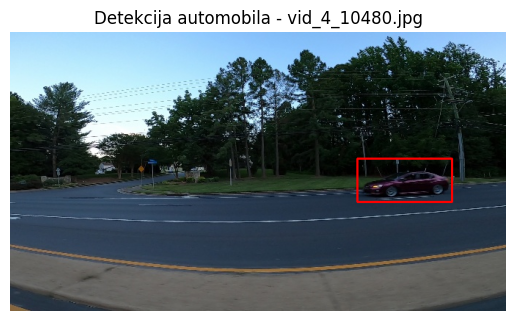

In [ ]:
import cv2
import matplotlib.pyplot as plt


# Bira se slika iz skupa (npr. deseta po redu u tabeli)
df_image_name = df['image'].iloc[10]
df_image_path = f"data/training_images/{df_image_name}"

# Učitava se slika i vrši se konverzija iz BGR (OpenCV) u RGB (za prikaz)
image = cv2.imread(df_image_path)
image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Uzimaju se sve anotacje koje se odnose na tu sliku
bounding_box_df = df[df['image'] == df_image_name]

# Iscrtavaju se bounding box-ovi na slici na osnovu koordinata
for _, row in bounding_box_df.iterrows():
    xmin, ymin, xmax, ymax = int(row['xmin']), int(row['ymin']), int(row['xmax']), int(row['ymax'])
    cv2.rectangle(img, (xmin, ymin), (xmax, ymax), color=(255, 0, 0), thickness=2)

# Prikazuju se slike sa anotacijama
plt.imshow(image)
plt.title(f"Detekcija automobila - {df_image_name}")
plt.axis('off')
plt.show()



## Podela podataka

Kada treniramo podatke potrebno je da ih treniramo na skupu sa već poznatim rešenjima. Ja imam skup fotografija "training_images" i CSV fajl za njega "train_solution_bounding_boxes.csv" koji sadrži anotacije. Da bih trenirala model na ovom skupu podataka ali i da bih proverila njegovu tačnost moram da podelim podatke na dva dela:
- Trening skup (train) - ovaj skup se koristi za učenje modela
- Validacioni skup (val) - ovaj skup se koristi za proveru tačnosti i performansi tokom treiniga

Prvo uzimam iz tabele sva jedinstvena imena fotografija, a to radim da ne bi došlo da podele anotacija vezanih za istu fotografiju na tenining i na validaciju da ne dođe do propuštanja podataka. Zatim pomoću funkcije train_test_split iz biblioteke sklearin.model_selection se deli skup svih jedinstvenih fotografija na trening (80%) i validacioni (20%) skup, to omogućavam argumentom test_size=0.2 čime se specificira da je test skup 20%, dok argument random_state=42 omogućava da se dobiju isti rezultati svaki put kada se kod pokrene.

In [ ]:
from sklearn.model_selection import train_test_split

images_list = df['image'].unique() # Uzima se lista svih slika sa jedinstvenim nazivom, zapravo naziv slike
train_images, val_images = train_test_split(images_list, test_size=0.2, random_state=42) # Podaci se dele na trening (80%) i validacioni (20%) skup


## Kreiranje direktorijuma

S obzirom na to da YOLO zahteva posebnu strukturu foldera radi lakšeg učitavanja podataka, potrebno je da strukturiramo podatke na odgovarajući način. Podatke je potrebno podeliti na foldere za fotografije posebno i anotacije posebno a oba foldera će biti podeljena na trening i validacione podatke. To radimo korišćenjem os.makedir() funkcije koja služi za kreiranje direktorijuma, a argument exist_ok=true omogućava uspešno izvršavanje programa i ako folder već postoji.

In [ ]:
import os

# Kreiraju se potrebni direktorijumi za slike i anotacije
for folder in ['images/train', 'images/val', 'labels/train', 'labels/val']:
    os.makedirs(f"data/{folder}", exist_ok=True) #Kreiraju se svi potrebni folderi, sprečava se greška ukoliko folder već postoji


## Konverzija anotacija i priprema podataka

Kao što sam morala direktorijume prilagoditi YOLO modelu, takođe moram i anotacije jer ih očekuje u specifičnom, različitom formatu, odnosno bounding box se definiše relativnim koordinatama (u odnosnu na širinu i visinu fotografije).

Na početku definišem funkciju convert_to_yolo kojoj se prosleđuju koordinate i dimenzije fotografije, a povratna vrednost je string sa YOLO anotacijama.
Relativnu x koordinatu dobijam tako što saberem xmin i xmax vrednost i podelim sa dva, čime se dobija apsolutna koordinata i zatim podelim sa širinom slike, isto radim za Y samo delim sa visinom, dobije se vrednost između 0 i 1. Da bi se dobila relativna širina bounding box-a potrebno je da oduzmem xmin od xmax i podelim sa širinom slike, isto tako i za visinu.
S obzirom na to da imam samo jednu klasu da detektujem u return pišem 0.

Sledeći deo koda nam služi za premeštanje slika u YOLO fajlove razdavajući ih na trening i validacione. Imam petlju koja prolazi kroz dva glavna skupa (train i val), u svakoj iteraciji split će biti train ili val a image_list je lista fotografija za taj skup. Zatim kad se uđe u tu petlju imam drugu koja prolazi kroz svaku sliku pojedinačno. Prvo moramo da definišemo putanje, odnosno da se uzme trenutna putanja slike, a zatim da se smesti u odgovarajući folder.
Zatim pomoću shutil.copy() premestimo, odnosno kopiramo sliku sa trenutne putanje na odgovarajuću u novoj stukturi fajlova.
Nakon toga učitavamo dimenzije slike i izvlačimo sve bounding box-ove za tu sliku.

Na kraju popunjavamo anotacije u fajl. Otvaramo fajl preko definisanje putanje i pišemo "w" što znači da služi za pisanje, ako ne postoji kreira se i piše a ako postoji prepisuje se. Sad se prolazi kroz svaki red za jednu sliku, odnosno svaki bounding box. Crtica _ se koristi jer iterows() vraća indeks reda koji mi ne treba. Poziva se kreirana funkcija convert_to_yolo(), konvertuje se i piše u fajl.

In [ ]:
import shutil

# Funkcija koja služi za konverziju koordinazta bounding box-a
def convert_to_yolo(row, image_width, image_height):
    x = ((row['xmin'] + row['xmax']) / 2) / image_width
    y = ((row['ymin'] + row['ymax']) / 2) / image_height
    width = (row['xmax'] - row['xmin']) / image_width
    height = (row['ymax'] - row['ymin']) / image_height
    return f"0 {x} {y} {width} {height}"

# Iteracija kroz trening i validacione skupove
for split, images_list in [('train', train_images), ('val', val_images)]:
    for image_name in images_list:
        # Putanje do slika
        image_path = f"data/training_images/{image_name}"
        new_image_path = f"data/images/{split}/{image_name}"
        label_path = f"data/labels/{split}/{image_name.replace('.jpg', '.txt')}"

        # Kopiraju se slike u YOLO strukturu foldera
        shutil.copy(image_path, new_image_path)

        # Učitavaju se dimenzije slike
        image = cv2.imread(image_path)
        h, w = img.shape[:2]

        # Izvlače se svi bounding box-ovi za datu sliku
        bounding_boxes = df[df['image'] == image_name]

        # Upisuju se YOLO anotacije u .txt fajl
        with open(label_path, "w") as f:
            for _, row in bounding_boxes.iterrows():
                yolo_line = convert_to_yolo(row, w, h)
                f.write(yolo_line + "\n")


## Kreiranje YAML konfiguracionog fajla za dataset

YOLO koristi YAML fajl da zna gdje se nalaze potrebni fajlovi, gde su trening a gde validacioni podaci, koliko ima klasa i slično.

Definišem YAML fajl i dodeljujem mu putanju do train i val foldera. Zatim pišem broj klasa "nc" koji je u ovom slučaju 1, samo automobili i naziv te klase.

Na kraju se kreirani fajl čuva na odgovarajuću lokaciju potrebnu YOLO za analizu podataka.

In [ ]:
dataset_yaml = """
train: ../data/images/train
val: ../data/images/val

nc: 1
names: ['car']
"""

# Čuvanje YAML skupa u YOLOv5 folderu
with open("/content/yolov5/car_dataset.yaml", "w") as f:
    f.write(dataset_yaml)


## Pokretanje treniranja modela

Sledeći korak i najbitniji jeste pokretanje treninga modela, što radi sledeća !python train.py naredba (! znači da se izvršava kao komanda u terminalu a ne kao kod). Naredba sadrži različite parametre koji omogućavaju različite, što bolje performanse treninga.
- `--img 640` određuje veličinu ulazne slike, 640 je dimenzija i ovo znači da će se svaka slika pre nego što se prosledi modelu da se skalira na veličinu 640x640 piksela.
- `--batch 16` predstavlja batch size, odnosno broj slika koje se obrađuju u jednoj iteraciji, što je veći batch size to je trening brži ali zahteva veće performanse
- `--epochs 10 ` označava broj epoha odnosno broj koliko puta model prolazi kroz ceo trening skup, što je broj veći to označava bolju obučenost programa, ali nije dobro ako je previše jer može doći do prilagođavanja i ne tako dobrih performansi na novom setu
- `--data /content/yolov5/car_dataset.yaml` putanja do fajla sa skupom podataka
- `--weights yolov5s.pt` predstavlja početne težine modela, ovde koristim predtrenirane težine, to znači da model ima osnovno razumevanje
- `--cache` služi za keširanje slika u memoriji da bi se omogućilo brže učitavanje, to može ubrzati trening jer ne moraju da se učitavaju slike u svakoj epohi
- `--save-period 1` označava učestalost čuvanja modela, 1 znači da će se model čuvati nakon svake epohe, služi za praćenje napretka i omogućava nastavak teninga nakon poslednje epohe ako se prekine nešto

Ovaj korak u suštini uči model da prepoznaje automobile na slikama, nakon ovog koraka trebalo bi sam da prepoznaje.


In [ ]:
!python train.py --img 640 --batch 16 --epochs 10 --data /content/yolov5/car_dataset.yaml --weights yolov5s.pt --cache --save-period 1


wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-06-21 21:31:48.984301: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750541509.023118   38728 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750541509.034723   38728 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 
wandb: W&B disabled due to login timeout.
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/car_dataset.yaml, hyp=da

## Detekcija objekata na test slikama

Nakon što je završen trening modela, potrebno je da se proveri kako funkcioniše na novim slikama iz foldera "testing_images".

Izvršava se komanda !python detect.py po istom principu kao i train, ali sa različitom svrhom i parametrima.
- `--weights runs/train/exp/weights/best.pt` koristi se za specificiranje putanje do težina koje će se koristiti za detekciju, napisana putanja predstavlja putanju do najbolje obučenog modela best.pt sa najboljim performansama
- `--img 640` koristi se za veličinu ulazne slike za detekciju, skaliraju se na dimenzije 640x640 piksela što treba da odgovara ulaznoj veličini slike pri treningu
- `--conf 0.25` predstavlja prag poverenja, što znači da će model sačuvati samo one detekcije kojima je pouzdanost veća od 0.25, a niže će biti ignorisane. Povećanjem praga se smanjuje broj lažno pozitivnih ali mogu da se izgube neke pouzdane, smanjenjem se dobija više detekcija ali i više lažnih
- `--source data/testing_images` izvor podataka na kojima se vrši detekcija
- `--save-txt` čuva rezultate detekcije u tekstualne fajlove, za svaku sliku za koju se izvrši detekcija biće kreiran fajl koji sadrži detektovane objekte, takođe biće sačuvana i slika sa iscrtanim bounding box-ovima

Na ovaj način se dobijaju predikcije.

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source data/testing_images --save-txt

detect: weights=['runs/train/exp/weights/best.pt'], source=data/testing_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-421-g79c4c31d Python-3.11.13 torch-2.6.0+cu124 CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/175 /content/yolov5/yolov5/data/testing_images/vid_5_25100.jpg: 384x640 (no detections), 320.7ms
image 2/175 /content/yolov5/yolov5/data/testing_images/vid_5_25120.jpg: 384x640 (no detections), 266.5ms
image 3/175 /content/yolov5/yolov5/data/testing_images/vid_5_25140.jpg: 384x640 (no detections), 261.1ms
image 4/175 /content/yol

## Vizualizacija detekcija na test slikama

Nakon generisanja predikcija na osnovu "testing_images" želim da proverim vizuelno kvalitet detekcija. Želim da prikažem nekoliko nasumično odabranih fotografija sa detekcijama.

Prvo uzimamo putanju do foldera u kome su detekcije sačuvane, to se obično nalazi u runs/detect/exp folderu. Zatim u all_images uzimamo sve slike koje se nalaze u tom folderu i onda nasumično biramo 5 slika za prikaz (svaki put kad se pokrene biće druge).

Prolazi kroz sve odabrane slike, pristupa im preko putanje i naziva slike i prikazuje ih.

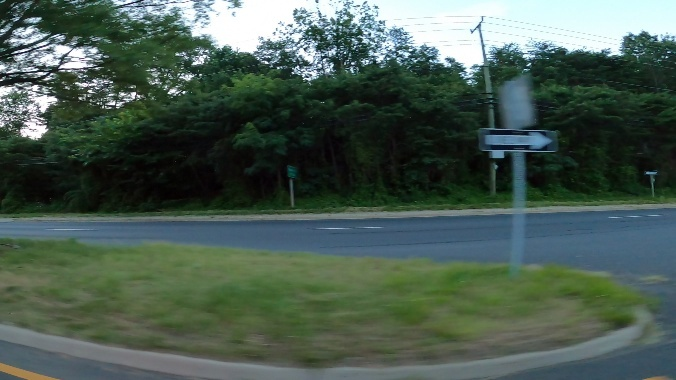

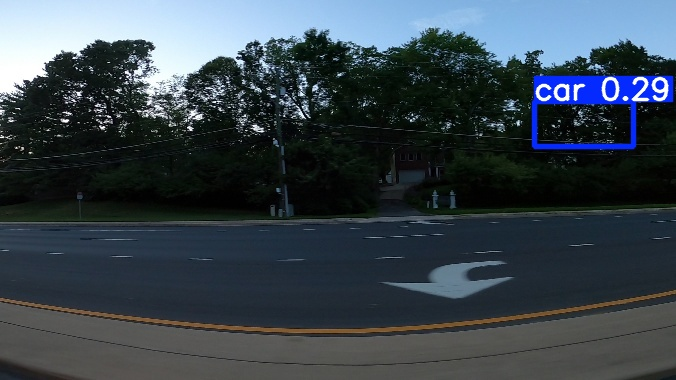

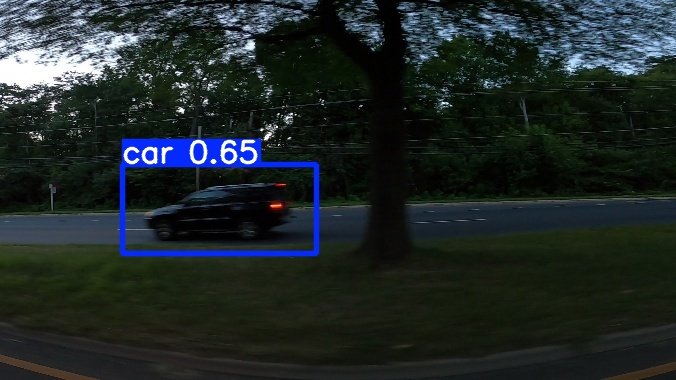

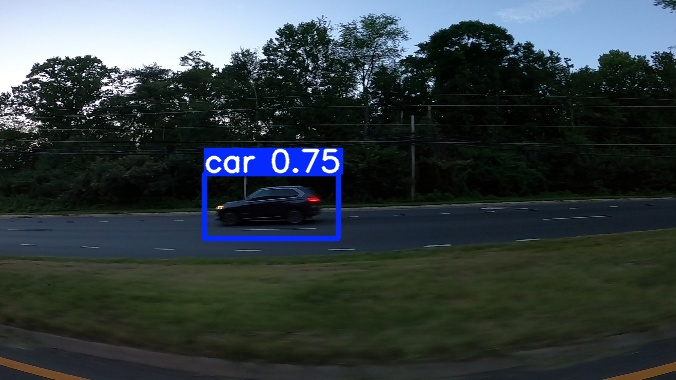

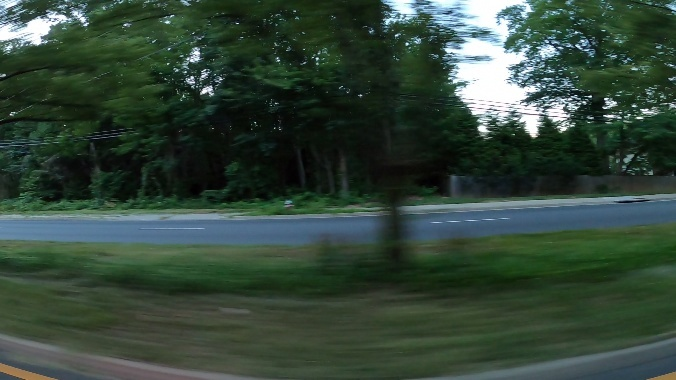

In [ ]:
import os
import random
from IPython.display import Image, display

# Putanja do foldera sa slikama sa detekcijama
results = 'runs/detect/exp'

# Uzimaju se sve slike koje se nalaze u folderu
all_images = [image for image in os.listdir(results) if img.endswith(('.jpg', '.png'))]

# Nasumično se uzima 5 slika koje će se prikazivati
random_images = random.sample(all_images, 5)

# Prikazuju se nasumično odabrane slike
for image_name in random_images:
    display(Image(filename=os.path.join(results, image_name)))


## Evaluacija modela tokom treninga

Sad želim da uradim evaluaciju modela koji sam dobila tokom treninga i da vizuelno prikažem rezultate.

Prvo želim da učitav CSV fajl sa rezultatima sa odgovarajuće putanje i da u kolonama obrišem nepotrebne razmake oko imena kolona ukoliko se desilo da su negde napisani pri generisnju fajla.

Zatim pozivom funkcije figure() iz biblioteke matplotlib.pyplot se kreira novi frame sa odgovarajućim dimenzijama u kom će biti prikazane sve potrebne metrike. Nakon toga se na grafiku crtaju metrike pomoću plot() funkcije. Epoch se koristi kao x osa i zapravo predstavlja progres treninga, train/box_loss se koristi kao y osa i meri koliko je model dobar u predviđanju tačnih koordinata bounding box-a, što je manji gubitak to je bolje. Još dodajem i labelu koja predstavlja ime linije u grafiku. Na isti način se crtaju i ostale metrike, train/obj_loss se odnosi na sposobnost modela da prepozna da li je objekat prisutan na slici na trening skupu, val/box_loss meri "box-loss" na validacionim podacima i ključno je jer pokazuje kako model prepoznaje podatke na skupu koji mu je nepoznat, val/obj_loss da li prepoznaje objekat na validacionom skupu. Najvažnija metrika je metrics/mAP_0.5 i predstavlja mean Average Precision na validacionom skupu ima prag 0.5 i daje vrednost koja predstavlja ukupne performanse detekcije objekata, što je mAP veći to je model bolji.

Na osnovu prikazanog grafika mogu da analiziram dobijene rezultate. Plava linija predstavlja Train Box Loss i vidim da se ona smanjuje iz epohe u epohu što je dobro jer znači da model nastavlja da uči. Takođe ima vrednost koja vremenom ide ispod 0.1 što je takođe dobro jer je mali broj što znači da ima manje grešaka. Narandžasta linija koja predstalja Train Object Loss takođe vremenom opada, i ima jako niske vrednosti, blizu 0, što znači da sigurno detektuje prisustvo objekta. Val Object Loss je sličan rezultatima sa trening skupa što znači da prilično dobro prepoznaje tačne koordinate i na podacima koji mu nisu poznati, ima nisku vrednost. Val Object Loss skoro je isti kao i Train Object Loss  i ima prilično dobre rezultate.
Ljubičasta linija je mAP i ona je najvažnija jer prikazuje sposobnost modela da detektuje objekte na validacionom skupu. Vidim da on raste ali da opada u 3. i u 6. epohi. To može biti zbog toga što je skup podataka manji pa su performanse nestabilnije, takođe može da se desi da u jednoj epohi model napravi nekoliko loših predikcija koje smanjuju mAP.

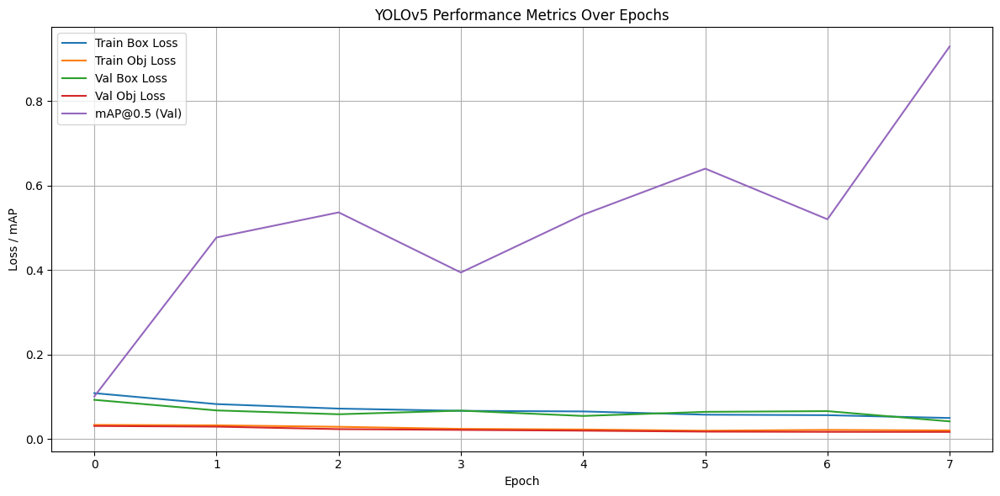

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Učitavaju se podaci i vrši se njihovo čišćenje
df = pd.read_csv('runs/train/exp/results.csv')
df.columns = df.columns.str.strip()  # Sklanjaja razmake oko imena kolona

# Prikazju se osnovne metrike tokom epoha
plt.figure(figsize=(12, 6))

plt.plot(df['epoch'], df['train/box_loss'], label='Train Box Loss')
plt.plot(df['epoch'], df['train/obj_loss'], label='Train Obj Loss')
plt.plot(df['epoch'], df['val/box_loss'], label='Val Box Loss')
plt.plot(df['epoch'], df['val/obj_loss'], label='Val Obj Loss')
plt.plot(df['epoch'], df['metrics/mAP_0.5'], label='mAP@0.5 (Val)')

plt.xlabel('Epoch') # Oznaka za x osu
plt.ylabel('Loss / mAP') # Oznaka za y osu
plt.title('YOLOv5 Performance Metrics Over Epochs') # Naslov grafika
plt.legend() # Prikazuje objašnjenje koja linija predstavlja koju metriku
plt.grid(True) # Mreža na pozadini za lakše čitanje vrednosti
plt.tight_layout() # Podešava parametre grafika
plt.show() # Prikazuje grafik


## Evaluacija na test skupu

S obzirom na to da za podatke koje koristim za testiranje "testing_images" nemam tačne anotacije na osnovu kojih bih mogla da uradim evaluaciju i testiram neke strandardne metrike kao što su mAP, Precision i Recall.
Zbog toga se moja evaluacija zasniva na analizi vizuelnih detekcija. Dakle imam prikaz slika sa detekcijama bounding box-ova gde može da se proveri da li model prepoznaje automobile uspešno.

Zbog toga želim da prikažem sve slike sa rezultatima da bih imala uvid u kompletno rešenje. Tako mogu da proverim da li su dobro postavljeni bounding box-ovi, da li ne prikazuje neke automobile, ili prikazuje tamo gde ne postoje.

Na osnovu prikazanih rezultata mogu da zaključim da je model sposoban da iskoristi znanje dobijeno tokom treninga i detektuje automobile na nepoznatim slikama.



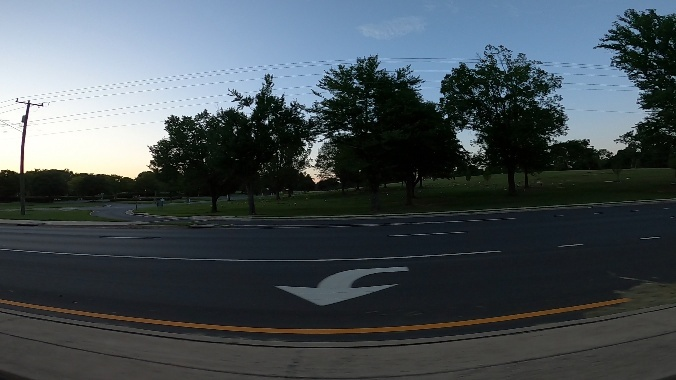

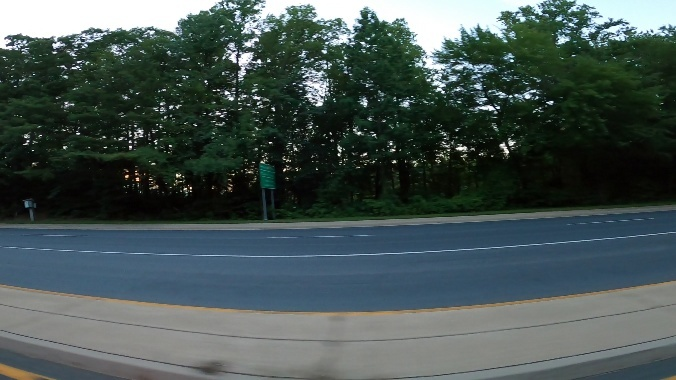

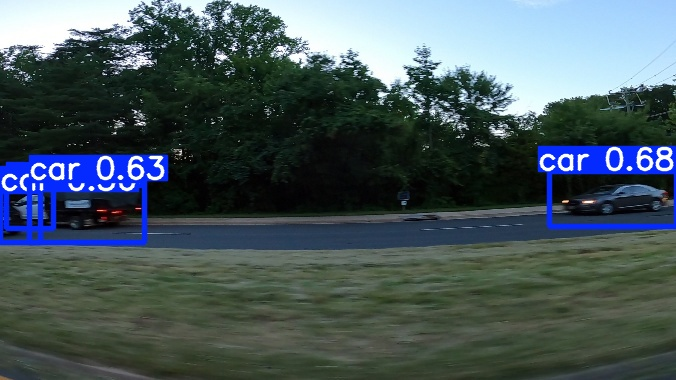

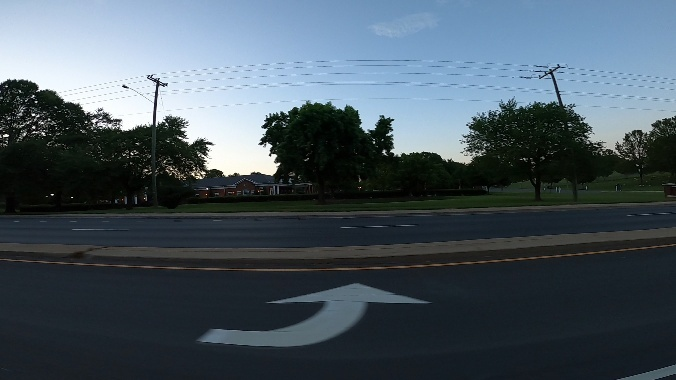

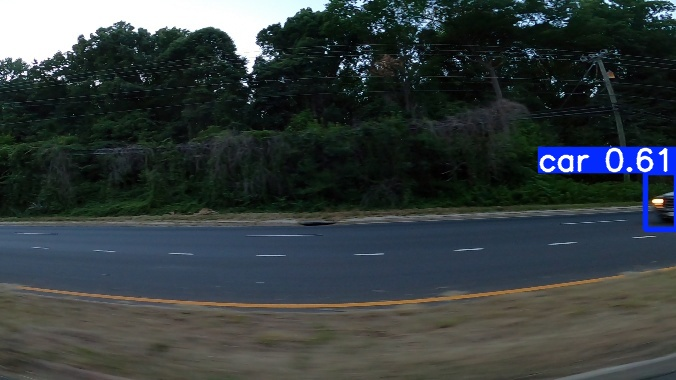

...

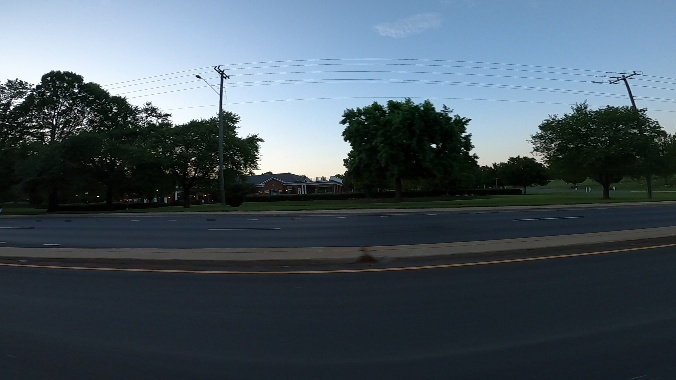

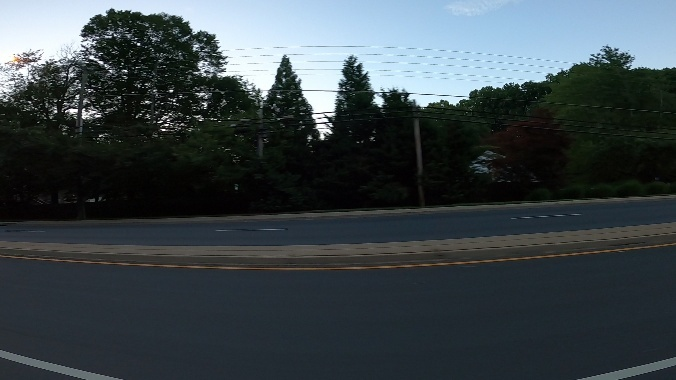

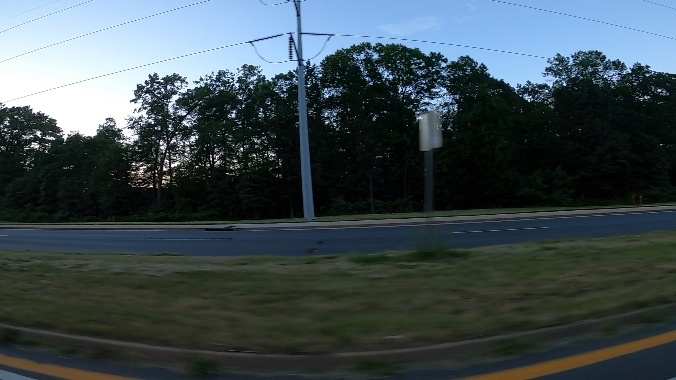

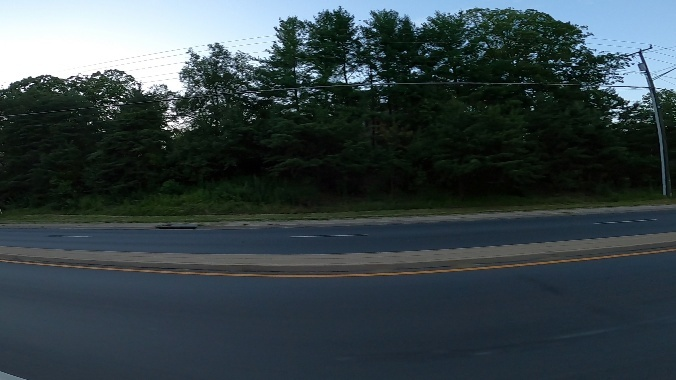

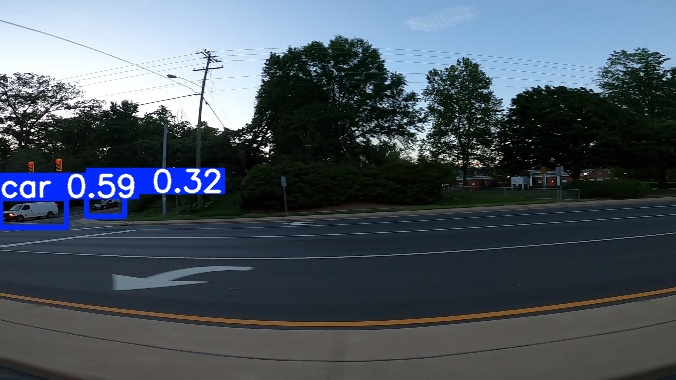

In [ ]:
from IPython.display import Image, display
import glob

# Pronalaze se sve slike iz bilo kog detect/exp foldera (exp, exp2, exp3...)
results = glob.glob('runs/detect/exp*/**.jpg', recursive=True)

# Prikazuju se sve slike jedna po jedna
for image_path in results:
    display(Image(filename=image_path))


## Generisanje submission fajla

Na kraju želim da podatke sačuvane u YOLO formatu u posebnim txt fajlovima konvertujem u CSV format i sačuvam te podatke.

Prvo želim da nađem foldere u kojima su sačuvani rezultati detekcije i zatim da uzmem sve slike iz test foldera.
Zatim prolazim kroz sve slike iz test skupa i pokušava da nađe fajl za tu sliku koji se zove isto kao slika. Ukoliko postoji znaci da postoje detekcije za tu sliku, otvara fajl i čita sve linije iz fajla. Za svaku liniju koja predstavlja jednu detekciju izvlači koordinate, zatim dodajem konvertovani bouding box u boxes gde se vrednosti formatiraju i spajaju u string, a sve bounding box-ove za trenutnu sliku spajamo u jedan veliki string. A ukoliko za trenutnu sliku nema detekcija stavljamo place holder da ne bi bilo NaN. Zatim u submission_data dodajem ime slike i string koji sadrži bounding box-ove. Na kraju se za podatke iz submission_data napravi DataFrame i sačuva se kao CSV fajl.

In [ ]:
import os
import pandas as pd

# Folder gde YOLOv5 čuva svoje detekcije u .txt fajlovima (isto ime kao slike, ali .txt)
labels = 'runs/detect/exp2/labels'
# Folder sa slikama na test skupu
images = 'data/testing_images'

submission_data = []

# Uzimaju se sve slike iz test foldera
test_images = [image for image in os.listdir(images) if image.endswith(('.jpg', '.png'))]

for image_name in test_images:
    # Odgovarajući .txt fajl sa predikcijama
    label_path = os.path.join(labels, image_name.replace('.jpg', '.txt').replace('.png', '.txt'))

    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            lines = f.readlines()
            bounding_boxes = []
            for line in lines:
                parts = line.strip().split() # Uklanja redove npr. i deli po razmacima
                x, y, width, height = map(float, parts[1:5]) # Konvertuje delove stringa u float

                # Pretvaranje u (xmin, ymin, xmax, ymax)
                xmin = x - width / 2
                ymin = y - height / 2
                xmax = x + width / 2
                ymax = y + height / 2

                bounding_boxes.append(f"{xmin} {ymin} {xmax} {ymax}")

            bounds_str = " ".join(bounding_boxes)
    else:
        # Ako nema detekcija za ovu sliku, stavimo placeholder da ne bi bilo NaN
        bounds_str = "0 0 1 1"

    submission_data.append({
        "image": image_name,
        "bounds": bounds_str
    })

# Napravi DataFrame i sačuva kao CSV
submission_df = pd.DataFrame(submission_data)
submission_df.to_csv("my_submission.csv", index=False)

print("Submission file 'my_submission.csv' je napravljen.")


Submission file 'my_submission.csv' je napravljen.


In [ ]:
# Vršimo učitavanje i prikaz nekoliko prvih redova fajla `my_submission.csv`
# kako bismo se uverili da je fajl uspešno kreiran i da su podaci formatirani ispravno.
df = pd.read_csv("my_submission.csv")

df.head()

,image,bounds
0,vid_5_31480.jpg,0 0 1 1
1,vid_5_26400.jpg,0 0 1 1
2,vid_5_26680.jpg,0 0 1 1
3,vid_5_31200.jpg,0 0 1 1
4,vid_5_28500.jpg,0 0 1 1


# Zaključak

Kao što vidimo, na osnovu dobijenog seta podataka uspela sam da treniram model i generišem rešenje koje je zadovoljavajuće. Uradila sam evaluaciju trening modela kao i vizuelnu evaluaciju detekcije nad testnim podacima, na kraju sam generisala CSV submission fajl u kom su izvezeni rezultati dobijeni u modelu.